In [3]:
#installing libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
!pip install gdown

In [5]:
import gdown

url = "https://drive.google.com/uc?id=1XXgJNTEl4p4APOAYsDXEFEk9XX-8lg07"
gdown.download(url, "accidents.csv", quiet=False)


Downloading...
From (original): https://drive.google.com/uc?id=1XXgJNTEl4p4APOAYsDXEFEk9XX-8lg07
From (redirected): https://drive.google.com/uc?id=1XXgJNTEl4p4APOAYsDXEFEk9XX-8lg07&confirm=t&uuid=62881337-de95-4be3-a241-cefd416e0f68
To: /content/accidents.csv
100%|██████████| 3.06G/3.06G [00:43<00:00, 69.7MB/s]


'accidents.csv'

In [6]:


chunks = pd.read_csv("/content/accidents.csv", chunksize=200000)
df=pd.concat(chunks)

## Q1. Spatial Distribution and Hotspots


In [7]:
sample_set=True
sample_fraction=0.1
if sample_set:
  df=df.sample(frac=sample_fraction,random_state=42).reset_index(drop=True)
print(f"original sample data shape:{df.shape}")
# check missing values in both columns
print("missing values in columns 'Start_Lat' and 'Start_Lng':")
print(df[['Start_Lat','Start_Lng']].isna().sum())

#drop rows with missing values
df.dropna(subset=['Start_Lat', 'Start_Lng'],inplace=True)
print(f"new sample data shape after dropping missing values:{df.shape}")
# Display only the first 5 rows to verify
print("Sample of 'Start_Lat' and 'Start_Lng' after dropping missing values:")

print(df[['Start_Lat', 'Start_Lng']].head())




original sample data shape:(772839, 46)
missing values in columns 'Start_Lat' and 'Start_Lng':
Start_Lat    0
Start_Lng    0
dtype: int64
new sample data shape after dropping missing values:(772839, 46)
Sample of 'Start_Lat' and 'Start_Lng' after dropping missing values:
   Start_Lat   Start_Lng
0  26.706900  -80.119360
1  38.781024 -121.265820
2  33.985249  -84.269348
3  47.118706 -122.556908
4  33.451355 -111.890343


In [8]:
import folium
from folium.plugins import HeatMap

# Create base map centered over US
m = folium.Map(location=[39.5, -98.35], zoom_start=4)

# Prepare location data
locations = df[['Start_Lat', 'Start_Lng']].sample(50000)  # sample for performance

# Add heatmap
HeatMap(locations.values, radius=6).add_to(m)

m


In [9]:
# top states by accident count
top_states = df['State'].value_counts().head(10)
top_states


,count
State,
CA,173589
FL,87287
TX,58139
SC,38511
NY,34490
NC,34152
VA,30534
PA,29706
MN,19317


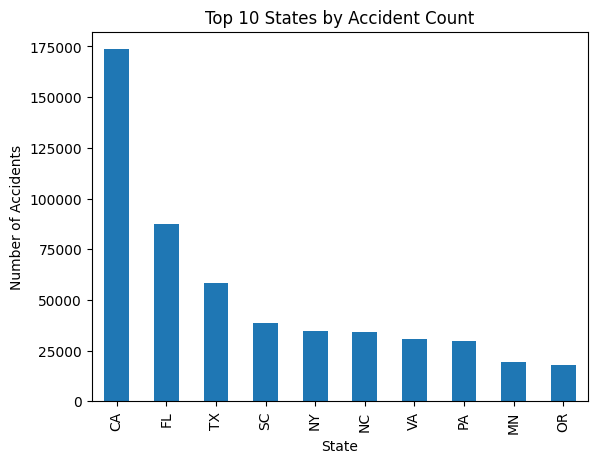

In [10]:
# vizualizing top 10 states by accident count
import matplotlib.pyplot as plt

top_states.plot(kind='bar', title='Top 10 States by Accident Count')
plt.ylabel('Number of Accidents')
plt.show()


In [11]:
#top cities by accident count
top_cities = df['City'].value_counts().head(10)
top_cities


,count
City,
Miami,18525
Houston,16937
Los Angeles,15628
Charlotte,14036
Dallas,13146
Orlando,10995
Austin,9715
Raleigh,8622
Nashville,7425


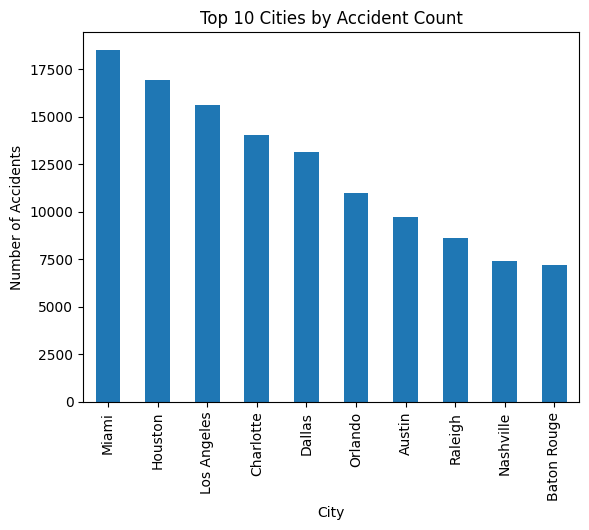

In [12]:
top_cities.plot(kind='bar', title='Top 10 Cities by Accident Count')
plt.ylabel('Number of Accidents')
plt.show()


In [ ]:
# observation
Hotspot Region 1: California
Reasons:
1.High population density
2.Heavy daily traffic

Hotspot Region 2: Texas
Reasons:
1.Long highway networks
2.High-speed traffic
3.Large vehicle volume

Q2. Spatial–Temporal Patterns within a State

In [17]:
# for state California
state = 'CA'
state_df = df[df['State'] == state].copy()
print(state_df.shape)

# extract hour and month features and creating new columns
state_df['Start_Time'] = pd.to_datetime(state_df['Start_Time'],format='mixed',
    errors='coerce')
state_df['Hour'] = state_df['Start_Time'].dt.hour
state_df['Month'] = state_df['Start_Time'].dt.month





(173589, 46)


<Axes: title={'center': 'Hourly Accident Distribution (CA)'}, xlabel='Hour'>

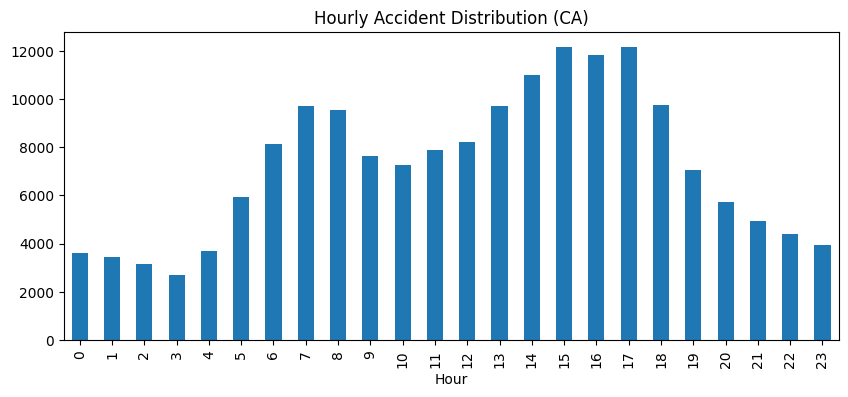

In [18]:
hourly_counts = state_df['Hour'].value_counts().sort_index()
hourly_counts.plot(kind='bar', figsize=(10,4), title='Hourly Accident Distribution (CA)')


<Axes: title={'center': 'Monthly Accident Distribution (CA)'}, xlabel='Month'>

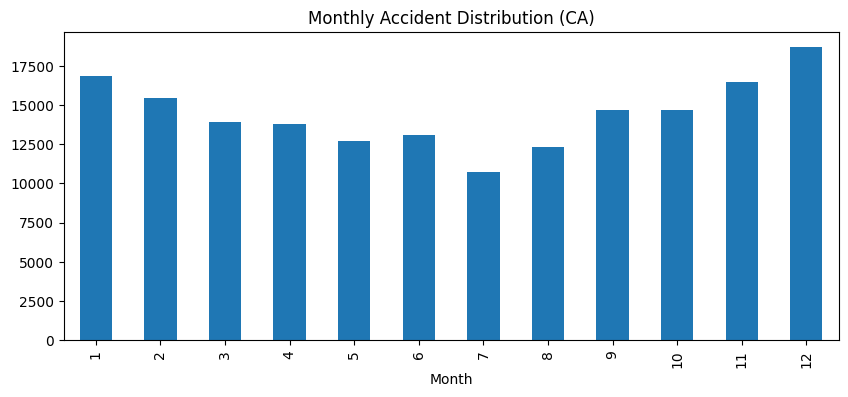

In [19]:
monthly_counts = state_df['Month'].value_counts().sort_index()

monthly_counts.plot(kind='bar', figsize=(10,4), title='Monthly Accident Distribution (CA)')


In [23]:
peak_df = state_df[state_df['Hour'].between(15, 18)]  # 3 PM – 6 PM
offpeak_df = state_df[state_df['Hour'].between(1, 4)] # late night

print("Peak accidents:", len(peak_df))
print("Off-peak accidents:", len(offpeak_df))

Peak accidents: 45882
Off-peak accidents: 13005


In [24]:
import folium
from folium.plugins import HeatMap
from IPython.display import display
#Peak-hour spatial heatmap
sample_size_peak = min(20000, len(peak_df))

m_peak = folium.Map(location=[36.7, -119.4], zoom_start=6)

HeatMap(
    peak_df[['Start_Lat', 'Start_Lng']]
    .sample(sample_size_peak, random_state=42)
    .values
).add_to(m_peak)

display(m_peak)




In [25]:
#Off-peak spatial heatmap
sample_size_off = min(20000, len(offpeak_df))

m_off = folium.Map(location=[36.7, -119.4], zoom_start=6)

HeatMap(
    offpeak_df[['Start_Lat', 'Start_Lng']]
    .sample(sample_size_off, random_state=42)
    .values
).add_to(m_off)

display(m_off)

In [26]:
high_accident_months = monthly_counts.nlargest(2).index.tolist()
low_accident_months = hourly_counts.nsmallest(2).index.tolist()

print("High accident months:", high_accident_months)
print("Low accident months:", low_accident_months)


High accident months: [12, 1]
Low accident months: [3, 2]


In [27]:
df_high_months = state_df[state_df['Month'].isin(high_accident_months)].copy()
df_low_months = state_df[state_df['Month'].isin(low_accident_months)].copy()

print("Accidents in high months:", df_high_months.shape[0])
print("Accidents in low months:", df_low_months.shape[0])


Accidents in high months: 35602
Accidents in low months: 29365


In [28]:
ca_center_lat = 36.7783
ca_center_lng = -119.4179

#Heatmap – HIGH accident months
m_high = folium.Map(location=[ca_center_lat, ca_center_lng], zoom_start=6)

sample_size_high = min(30000, len(df_high_months))

HeatMap(
    df_high_months[['Start_Lat', 'Start_Lng']]
    .sample(sample_size_high, random_state=42)
    .values,
    radius=8,
    min_opacity=0.5
).add_to(m_high)

display(m_high)


In [29]:
#Heatmap – LOW accident months
m_low = folium.Map(location=[ca_center_lat, ca_center_lng], zoom_start=6)

sample_size_low = min(30000, len(df_low_months))

HeatMap(
    df_low_months[['Start_Lat', 'Start_Lng']]
    .sample(sample_size_low, random_state=42)
    .values,
    radius=8,
    min_opacity=0.5
).add_to(m_low)

display(m_low)


Q3. Geospatial Correlates of Severity  

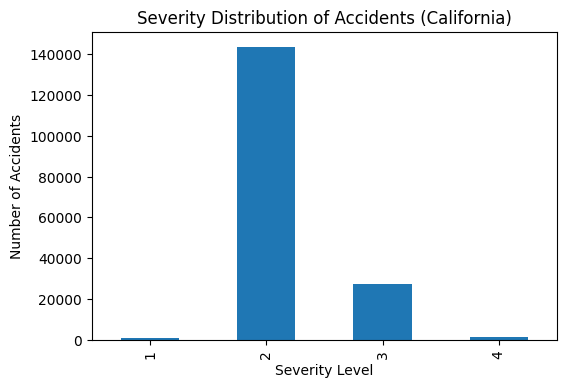

In [30]:
#Severity distribution

severity_counts = state_df['Severity'].value_counts().sort_index()

severity_counts.plot(
    kind='bar',
    title='Severity Distribution of Accidents (California)',
    figsize=(6,4)
)
plt.xlabel("Severity Level")
plt.ylabel("Number of Accidents")
plt.show()


In [32]:
# 7. Color mapping for severity levels
severity_colors = {
    1: 'green',   # Minor
    2: 'blue',    # Moderate (most frequent)
    3: 'orange',  # Serious
    4: 'red'      # Severe
}

# 8. Create base map centered on California
m_all_severity = folium.Map(
    location=[36.7783, -119.4179],
    zoom_start=6
)

# 9. Sample points for visualization (avoid crash)
sample_size = min(15000, len(state_df))
sample_df = state_df.sample(sample_size, random_state=42)

# 10. Plot ALL severity accidents with different colors
for _, row in sample_df.iterrows():
    sev = row['Severity']
    color = severity_colors.get(sev, 'gray')

    folium.CircleMarker(
        location=[row['Start_Lat'], row['Start_Lng']],
        radius=3,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=f"Severity: {sev}"
    ).add_to(m_all_severity)

# 11. Display map
display(m_all_severity)


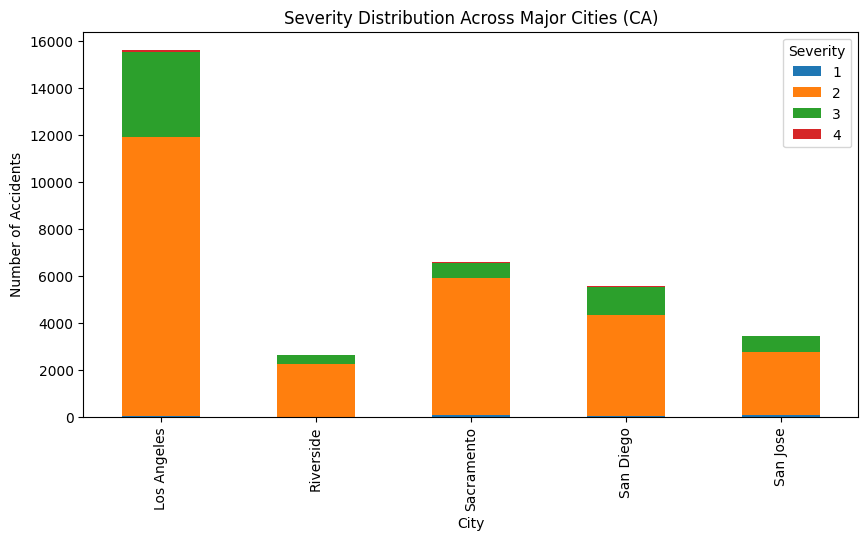

In [33]:
#Severity comparison across cities

top_cities = state_df['City'].value_counts().head(5).index

city_severity = (
    state_df[state_df['City'].isin(top_cities)]
    .groupby(['City', 'Severity'])
    .size()
    .unstack(fill_value=0)
)

city_severity.plot(
    kind='bar',
    stacked=True,
    figsize=(10,5),
    title='Severity Distribution Across Major Cities (CA)'
)
plt.ylabel("Number of Accidents")
plt.show()

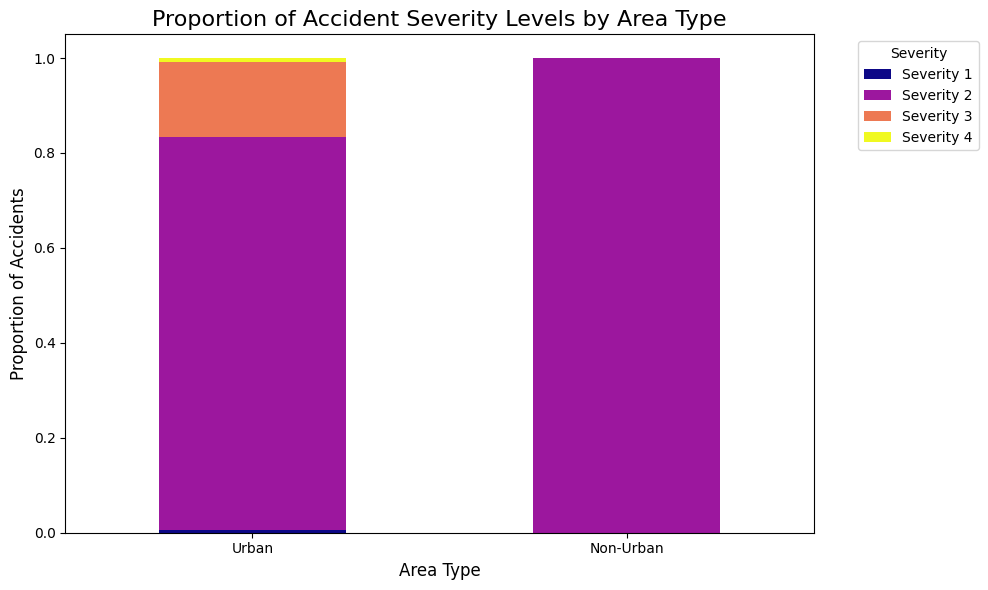

In [39]:
#Urban vs non-urban severity comparison
state_df['Urban'] = state_df['City'].notna()

urban_severity = (
    state_df.groupby(['Urban', 'Severity'])
    .size()
    .unstack(fill_value=0)
)
severity_counts_area = urban_severity.reindex(
    [True, False], fill_value=0
)

# 4. Rename index to readable labels
severity_counts_area.index = ['Urban', 'Non-Urban']
severity_proportions_area = severity_counts_area.div(
    severity_counts_area.sum(axis=1), axis=0)

# 4. Plot stacked bar chart
ax_area = severity_proportions_area.plot(
    kind='bar',
    stacked=True,
    figsize=(10, 6),
    colormap='plasma'
)

plt.title('Proportion of Accident Severity Levels by Area Type', fontsize=16)
plt.xlabel('Area Type', fontsize=12)
plt.ylabel('Proportion of Accidents', fontsize=12)
plt.xticks(rotation=0)

# 7. Legend customization
handles_area, labels_area = ax_area.get_legend_handles_labels()

severity_labels = {
    1: 'Severity 1',
    2: 'Severity 2',
    3: 'Severity 3',
    4: 'Severity 4'
}

new_labels_area = [severity_labels.get(int(label), label) for label in labels_area]

plt.legend(
    handles_area,
    new_labels_area,
    title='Severity',
    bbox_to_anchor=(1.05, 1),
    loc='upper left'
)

plt.tight_layout()
plt.show()

In [35]:
#Relate severity to a contextual factor (Weather)
weather_severity = (
    state_df.groupby(['Weather_Condition', 'Severity'])
    .size()
    .unstack(fill_value=0)
)

weather_severity['High_Severity_Ratio'] = (
    weather_severity[3] + weather_severity[4]
) / weather_severity.sum(axis=1)

weather_severity.sort_values(
    'High_Severity_Ratio', ascending=False
).head(10)

Severity,1,2,3,4,High_Severity_Ratio
Weather_Condition,,,,,
Heavy Drizzle,0,0,3,0,1.000000
Thunderstorm,0,0,1,0,1.000000
Light Freezing Fog,0,1,2,0,0.666667
Heavy Thunderstorms and Rain,0,2,2,0,0.500000
Hail,0,1,1,0,0.500000
Rain Showers,0,6,5,0,0.454545
Scattered Clouds,3,1758,1149,26,0.400204
Overcast,1,3532,2285,71,0.400068
Light Thunderstorms and Rain,0,3,2,0,0.400000


In [40]:
print("Unique values and counts for column 'Junction':")
print(df['Junction'].value_counts(dropna=False))

Unique values and their counts for 'Junction' column:
Junction
False    716129
True      56710
Name: count, dtype: int64


In [8]:
mean_severity_junction_true = df[df['Junction'] == True]['Severity'].mean()
mean_severity_junction_false = df[df['Junction'] == False]['Severity'].mean()

print(f"Mean Severity for accidents at a Junction where Junction=True : {mean_severity_junction_true:.3f}")
print(f"Mean Severity for accidents not at a Junction where Junction=False : {mean_severity_junction_false:.3f}")

Mean Severity for accidents at a Junction where Junction=True : 2.298
Mean Severity for accidents not at a Junction where Junction=False : 2.206


/tmp/ipython-input-943785789.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Junction Type', y='Mean Severity', data=severity_data, palette='coolwarm')


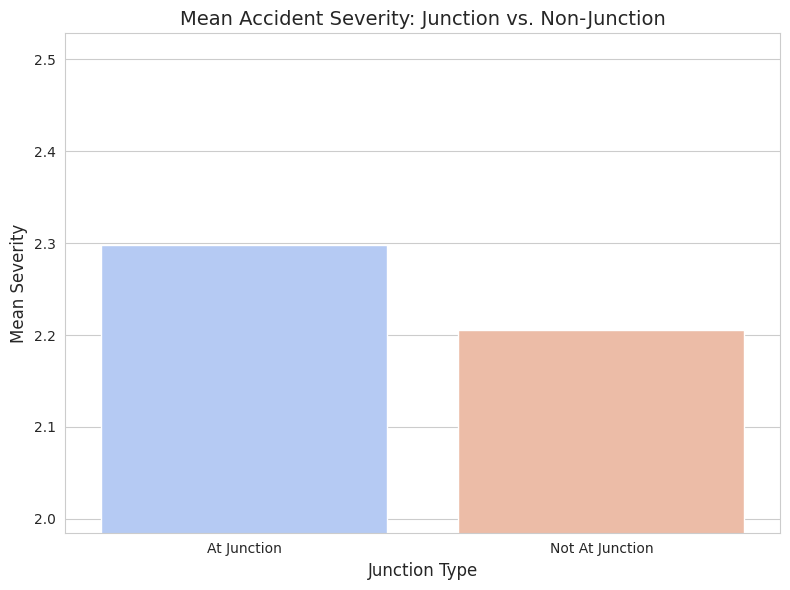

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Creating  DataFrame to plot
severity_data = pd.DataFrame({
    'Junction Type': ['At Junction', 'Not At Junction'],
    'Mean Severity': [mean_severity_junction_true, mean_severity_junction_false]
})
sns.set_style("whitegrid")

# Bar plot
plt.figure(figsize=(8, 6))
sns.barplot(x='Junction Type', y='Mean Severity', data=severity_data, palette='coolwarm')
plt.title('Mean Accident Severity: Junction vs. Non-Junction', fontsize=14)
plt.xlabel('Junction Type', fontsize=12)
plt.ylabel('Mean Severity', fontsize=12)
plt.ylim(severity_data['Mean Severity'].min() * 0.9, severity_data['Mean Severity'].max() * 1.1)
plt.tight_layout()
plt.show()